<a href="https://www.kaggle.com/code/nadaaglan/rcnn-drop-classes?scriptVersionId=180250254" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="pBgyltHaxBfEFNMlUFmm")
project = rf.workspace("dent-dataset").project("rcnn-drop-classes")
version = project.version(1)
dataset = version.download("coco")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 34.6 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uninstalled cycler-0.12.1
  Attempting uninstall: certifi
    Found existing installation: certifi 2


Extracting Dataset Version Zip to RCNN-drop-classes-1 in coco:: 100%|██████████| 1095/1095 [00:00<00:00, 6046.92it/s]


In [2]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'
# check pytorch installation:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-j4pyui7k
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-j4pyui7k
  Resolved https://github.com/facebookresearch/detectron2.git to commit eb96ee1d4752ff5896f623f738641fba9c755237
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.0/76.0 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 9.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 30.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 69

In [6]:
"""
You can use this package to convert labelme annotations to COCO format.
https://github.com/fcakyon/labelme2coco
"""
#!pip install labelme2coco
!pip install labelme2coco


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.4/88.4 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.8/61.8 MB 27.0 MB/s eta 0:00:00:00:0100:01
  Created wheel for fire: filename=fire-0.6.0-py2.py3-none-any.whl size=117031 sha256=fa5c0985ca4235ecdfe129bbdd4f3a422ef7cb219c88d380d81b91d3884e1039
  Stored in directory: /root/.cache/pip/wheels/d6/6d/5d/5b73fa0f46d01a793713f8859201361e9e581ced8c75e5c6a3
Successfully built fire
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.9.0.80
    Uninstalling opencv-python-4.9.0.80:
      Successfully uninstalled opencv-python-4.9.0.80
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 1.4.0 requires opencv-python>=4.9.0, but you hav

In [3]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

# Register Custom Detectron2 Data
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/kaggle/working/RCNN-drop-classes-1/train/_annotations.coco.json", "/kaggle/working/RCNN-drop-classes-1/train")
register_coco_instances("my_dataset_test", {},  "/kaggle/working/RCNN-drop-classes-1/test/_annotations.coco.json", "/kaggle/working/RCNN-drop-classes-1/test")

print("Done...")


Done...


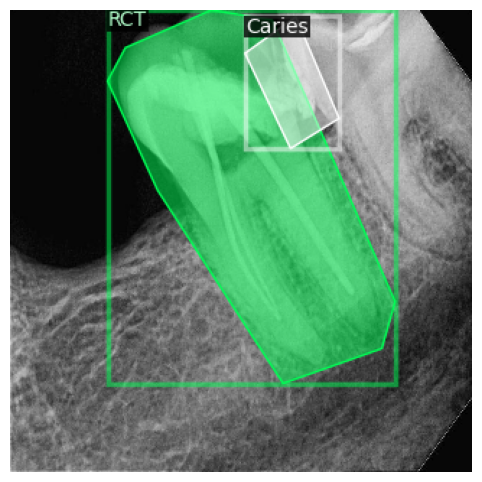

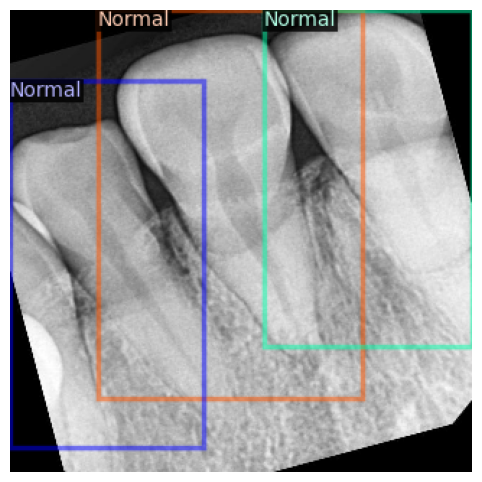

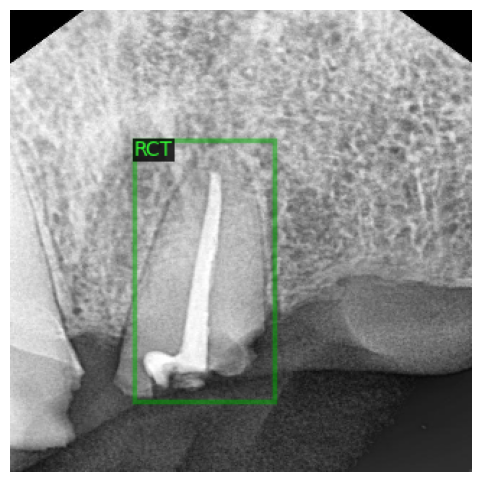

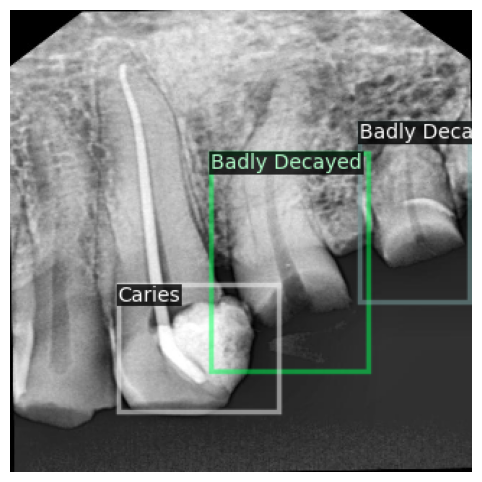

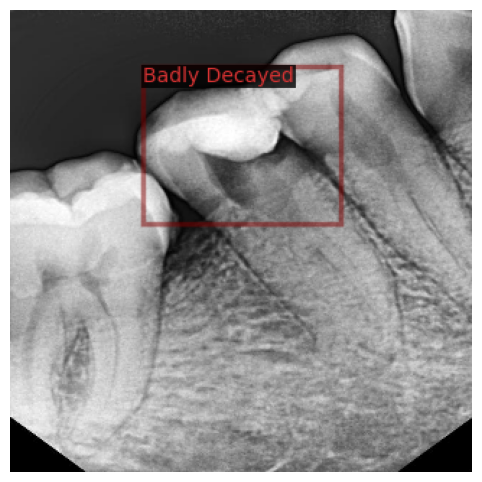

In [7]:
import matplotlib.pyplot as plt

# visualize training data
from detectron2.data import MetadataCatalog, DatasetCatalog
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer
import cv2

for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    
    # Display using matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis('off')
    plt.show()


In [ ]:
# Train the model
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
from detectron2 import model_zoo

# faster_rcnn
model_link = "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"

# Detectron2.config package
# https://detectron2.readthedocs.io/modules/config.html

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(model_link))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model_link)
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00020
cfg.SOLVER.MAX_ITER = 900
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 8
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6

#cfg.MODEL.CUDA_LAUNCH_BLOCKING = 0
cfg.MODEL.CUDA_LAUNCH_BLOCKING = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

In [9]:
# Test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.engine import DefaultPredictor
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.50
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)


Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.112
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.274
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.017
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.114
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.214
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.436
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.150
 Average Recall     (AR) @[ IoU=0.50:0.

OrderedDict([('bbox',
              {'AP': 11.24667384065436,
               'AP50': 27.44498939092591,
               'AP75': 7.412679354263712,
               'APs': 0.0,
               'APm': 1.666666666666667,
               'APl': 11.39524833326158,
               'AP-dental-SIX3': nan,
               'AP-Badly Decayed': 3.6604907987447324,
               'AP-Caries': 1.6520570135473152,
               'AP-Normal': 9.439751340036713,
               'AP-RCT': 16.231283151500268,
               'AP-Restoration': 25.249786899442782})])

[03/27 13:20:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


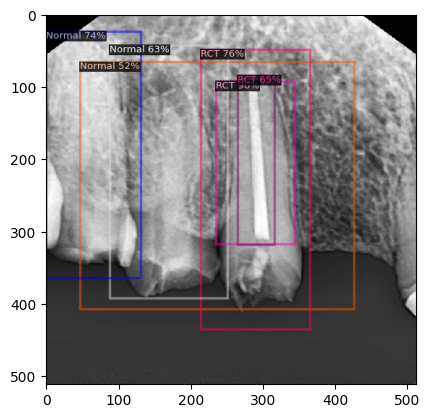

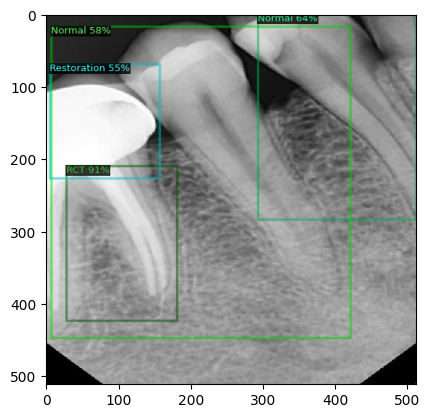

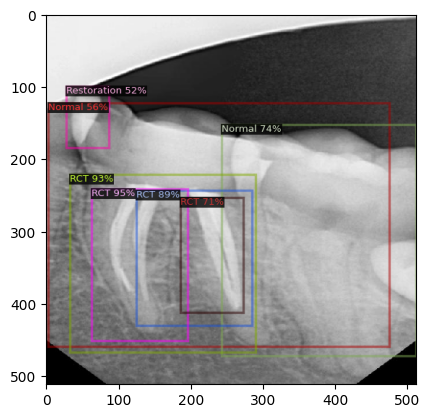

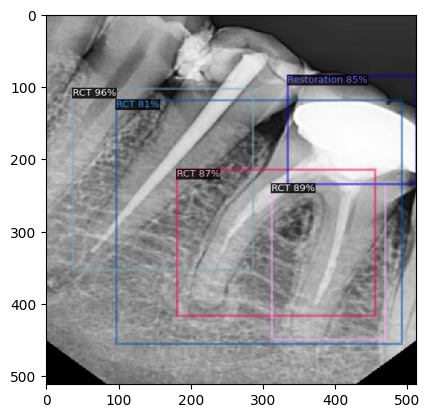

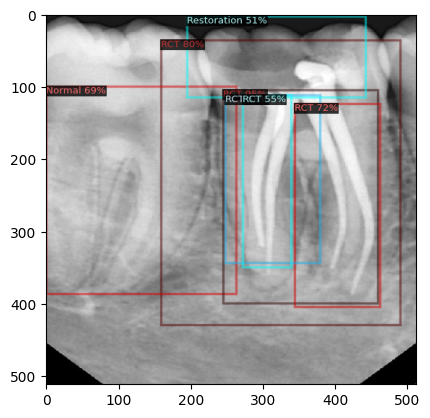

In [14]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")


from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob("/kaggle/working/RCNN-drop-classes-1/test/*jpg")[:5]:
    im = cv2.imread(imageName)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.show()
    print("\n")

In [12]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import matplotlib.pyplot as plt

[03/27 13:21:15 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /kaggle/working/output/model_final.pth ...
Classes : 
 tensor([4, 4, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.8987, 0.7573, 0.7377, 0.6473, 0.6342], device='cuda:0')


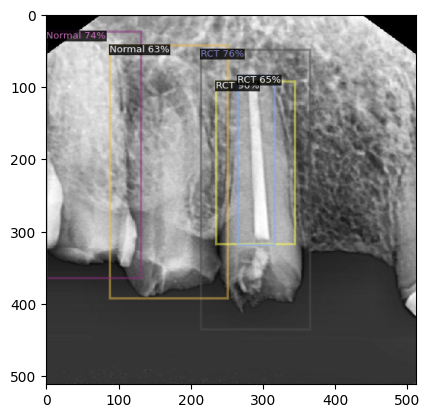



Classes : 
 tensor([4, 3], device='cuda:0')
Scores : 
 tensor([0.9113, 0.6427], device='cuda:0')


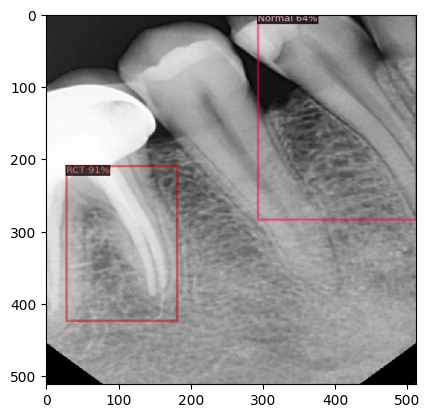



Classes : 
 tensor([4, 4, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.9467, 0.9272, 0.8868, 0.7361, 0.7060], device='cuda:0')


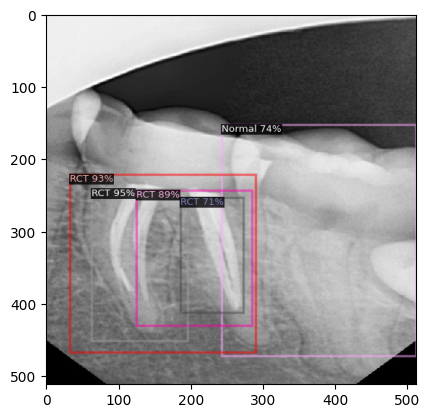



Classes : 
 tensor([4, 4, 4, 5, 4], device='cuda:0')
Scores : 
 tensor([0.9564, 0.8890, 0.8737, 0.8535, 0.8109], device='cuda:0')


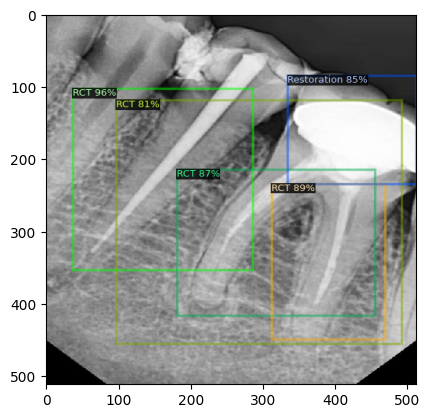



Classes : 
 tensor([4, 4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9514, 0.7986, 0.7193, 0.6896], device='cuda:0')


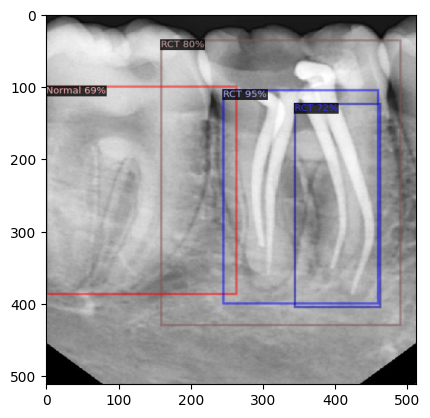



Classes : 
 tensor([4, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8548, 0.7585, 0.7242, 0.6206], device='cuda:0')


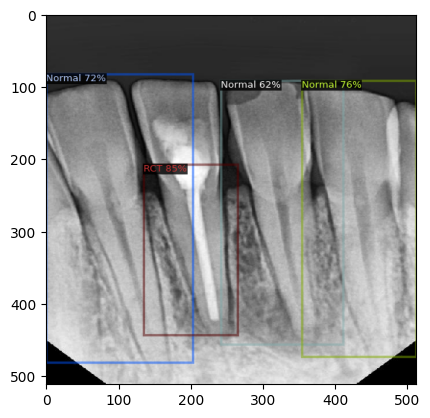



Classes : 
 tensor([5, 3, 5], device='cuda:0')
Scores : 
 tensor([0.9212, 0.7133, 0.6442], device='cuda:0')


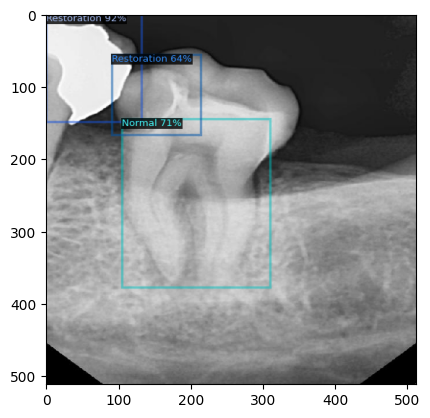



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8373, 0.6801, 0.6760, 0.6671], device='cuda:0')


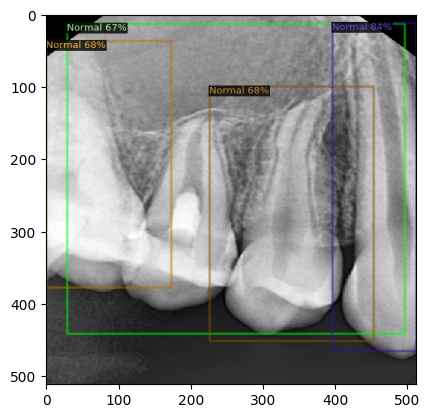



Classes : 
 tensor([5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9291, 0.7414, 0.6364], device='cuda:0')


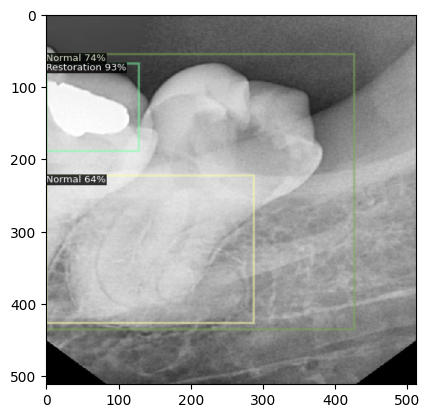



Classes : 
 tensor([4, 5, 4, 4], device='cuda:0')
Scores : 
 tensor([0.9375, 0.9325, 0.8850, 0.8200], device='cuda:0')


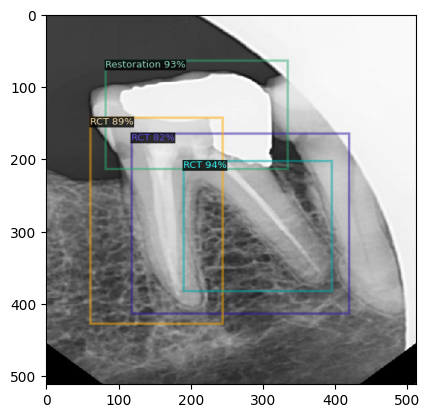



Classes : 
 tensor([5, 4, 3, 3, 4, 5, 3], device='cuda:0')
Scores : 
 tensor([0.8722, 0.8559, 0.8360, 0.6832, 0.6617, 0.6561, 0.6168],
       device='cuda:0')


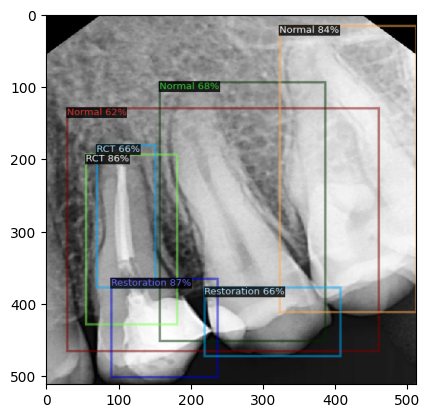



Classes : 
 tensor([4, 4, 4, 5, 5, 4], device='cuda:0')
Scores : 
 tensor([0.9408, 0.8340, 0.7503, 0.7462, 0.6493, 0.6156], device='cuda:0')


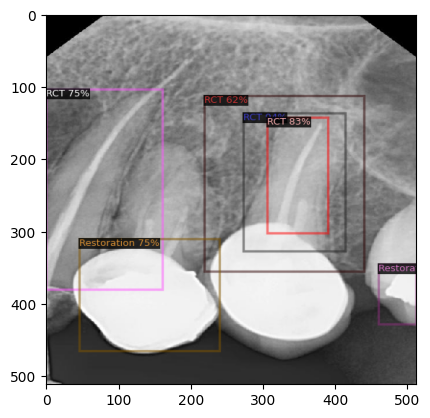



Classes : 
 tensor([4, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9657, 0.8211, 0.6996, 0.6433], device='cuda:0')


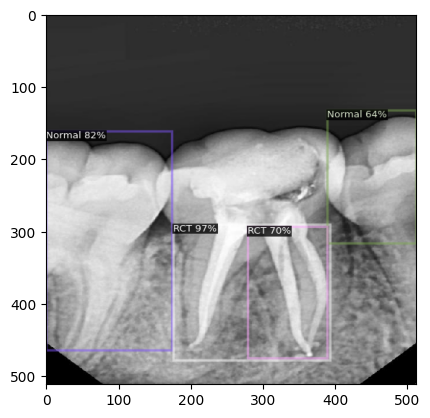



Classes : 
 tensor([3, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.7438, 0.7423, 0.7188, 0.6093], device='cuda:0')


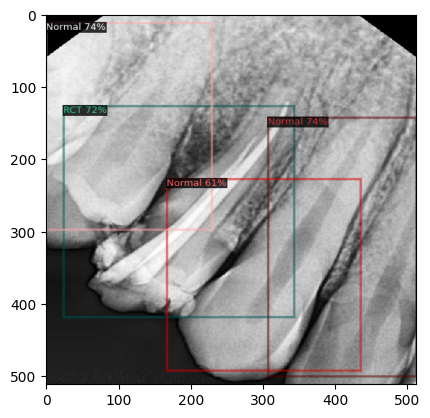



Classes : 
 tensor([4, 3, 3, 5, 5], device='cuda:0')
Scores : 
 tensor([0.8115, 0.7773, 0.7575, 0.6707, 0.6530], device='cuda:0')


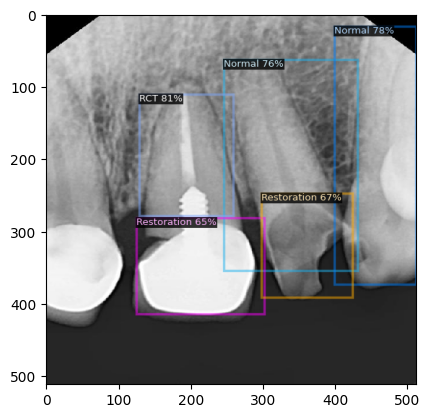



Classes : 
 tensor([4, 4, 4, 3, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8937, 0.8564, 0.7684, 0.7576, 0.7140, 0.7065], device='cuda:0')


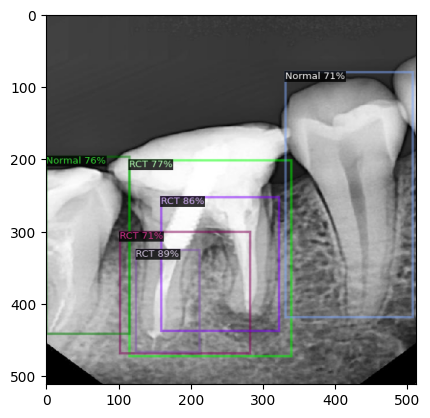



Classes : 
 tensor([4, 3, 3, 5, 5, 3], device='cuda:0')
Scores : 
 tensor([0.8177, 0.7907, 0.6906, 0.6232, 0.6127, 0.6065], device='cuda:0')


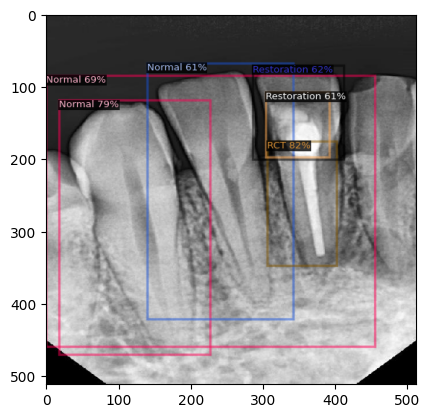



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8131, 0.7911, 0.7557], device='cuda:0')


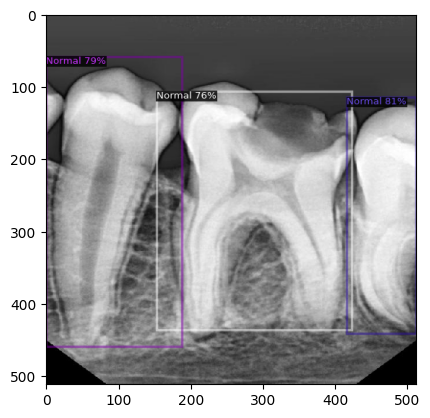



Classes : 
 tensor([4, 5, 4, 5, 4, 5, 5], device='cuda:0')
Scores : 
 tensor([0.9052, 0.9014, 0.8950, 0.7718, 0.6687, 0.6230, 0.6133],
       device='cuda:0')


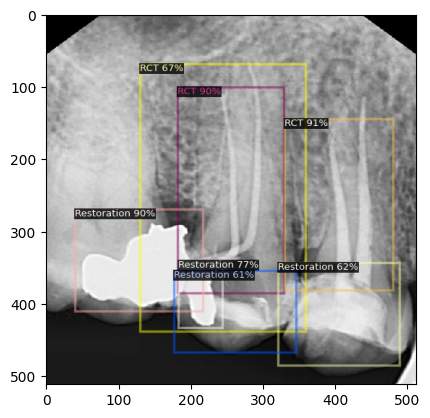



Classes : 
 tensor([3, 3, 3, 5], device='cuda:0')
Scores : 
 tensor([0.8620, 0.8194, 0.7161, 0.6562], device='cuda:0')


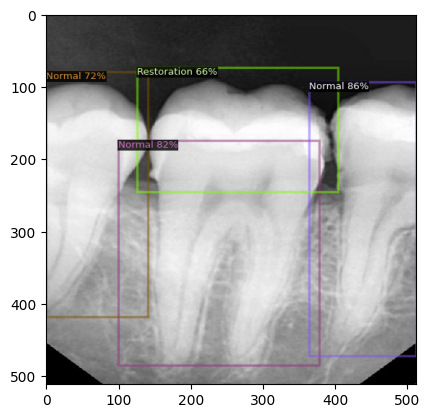



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.7742, 0.7334], device='cuda:0')


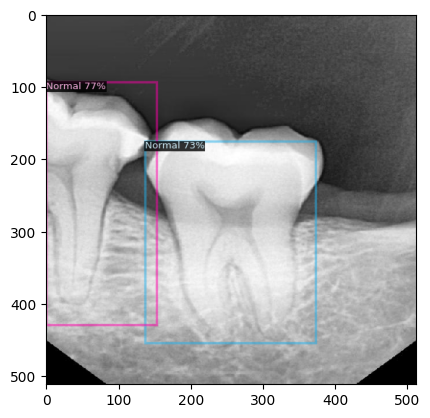



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7590, 0.7415, 0.6512], device='cuda:0')


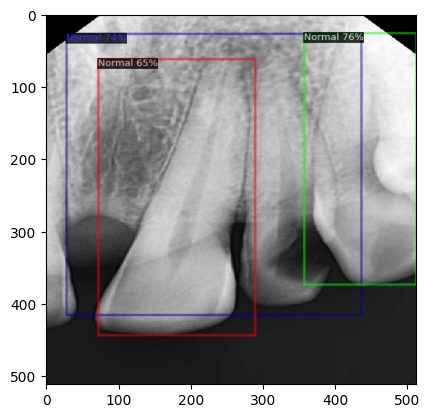



Classes : 
 tensor([3, 5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7822, 0.7546, 0.7359, 0.7104], device='cuda:0')


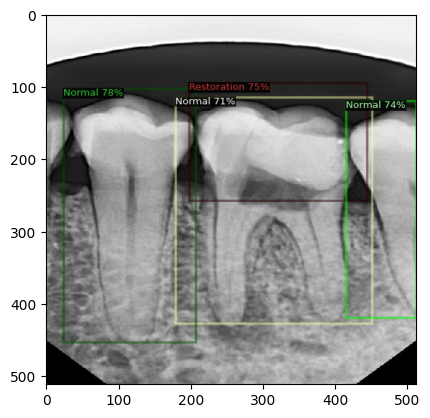



Classes : 
 tensor([4, 4, 3, 4, 4], device='cuda:0')
Scores : 
 tensor([0.9213, 0.8746, 0.8165, 0.7725, 0.6606], device='cuda:0')


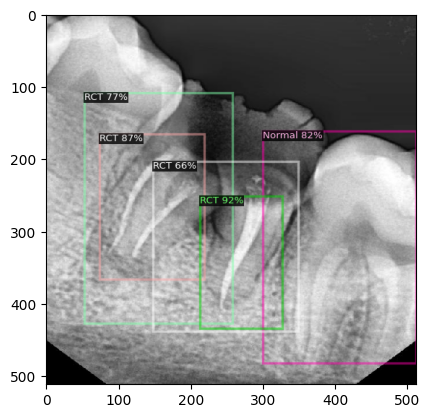



Classes : 
 tensor([4, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9519, 0.8071, 0.6856, 0.6075], device='cuda:0')


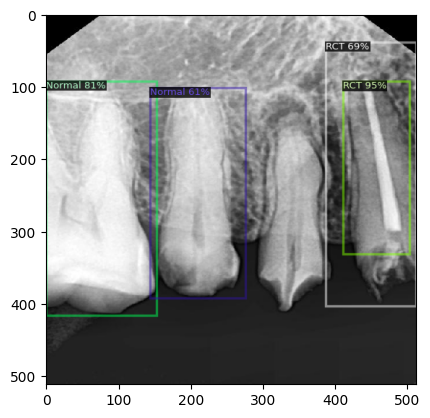



Classes : 
 tensor([4, 5, 3, 4, 4, 5], device='cuda:0')
Scores : 
 tensor([0.8933, 0.8144, 0.8128, 0.7159, 0.6573, 0.6535], device='cuda:0')


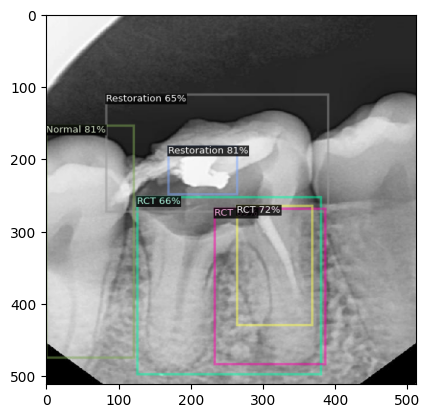



Classes : 
 tensor([4, 3, 5], device='cuda:0')
Scores : 
 tensor([0.9818, 0.7550, 0.6791], device='cuda:0')


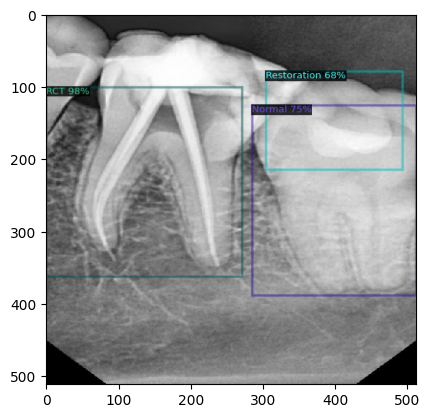



Classes : 
 tensor([4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.7861, 0.7309, 0.6634], device='cuda:0')


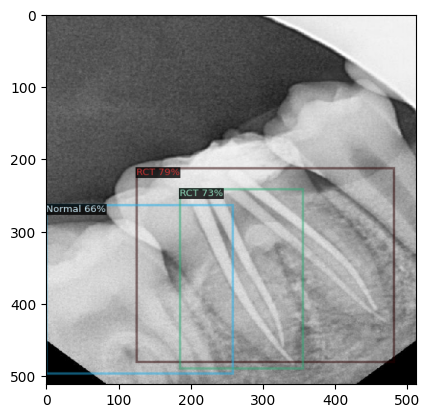



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8242, 0.7732, 0.7141], device='cuda:0')


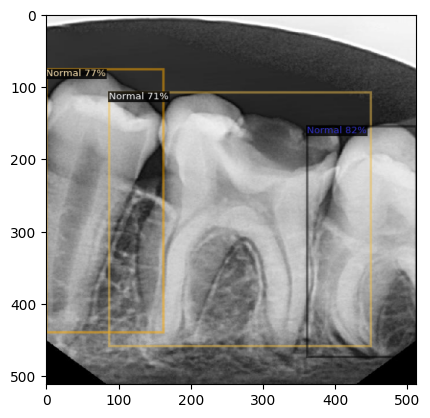



Classes : 
 tensor([4, 4, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.9504, 0.8185, 0.7780, 0.7466, 0.7126], device='cuda:0')


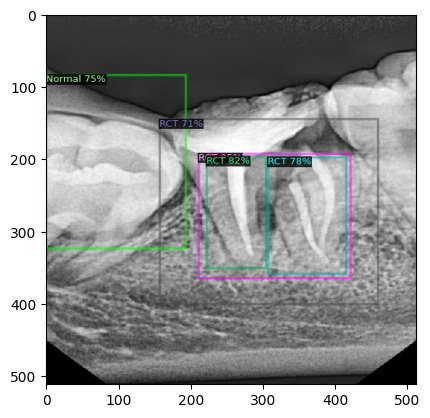



Classes : 
 tensor([4, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.9275, 0.7035, 0.6633, 0.6316], device='cuda:0')


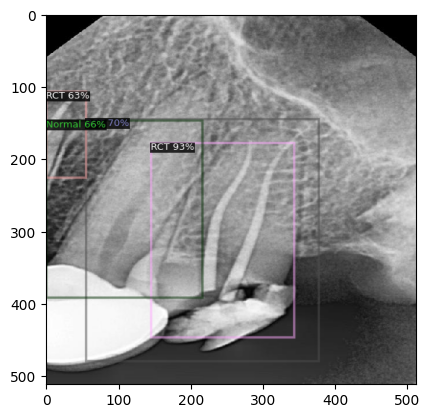



Classes : 
 tensor([3, 3, 3, 5], device='cuda:0')
Scores : 
 tensor([0.7741, 0.7512, 0.7314, 0.7104], device='cuda:0')


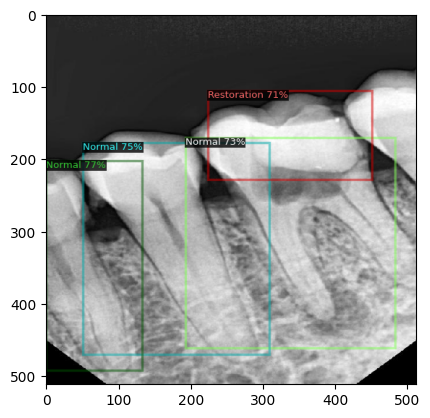



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7404, 0.6562, 0.6303], device='cuda:0')


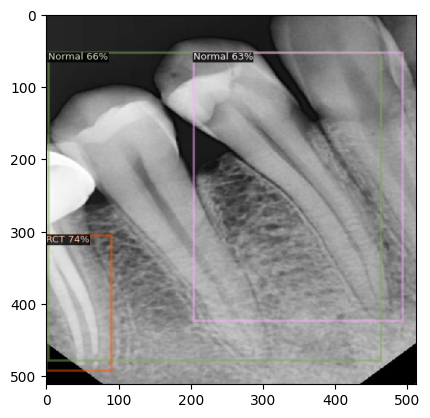



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7464, 0.7125, 0.6729, 0.6362], device='cuda:0')


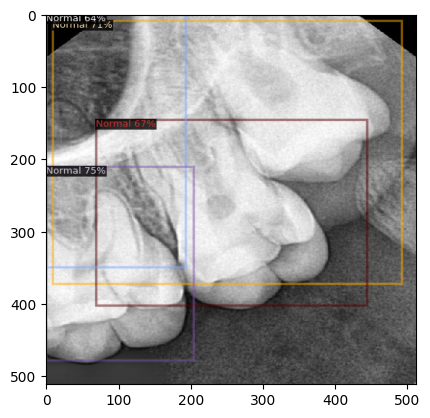



Classes : 
 tensor([4, 4], device='cuda:0')
Scores : 
 tensor([0.9403, 0.6442], device='cuda:0')


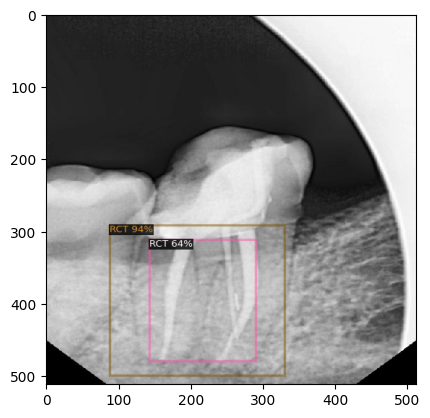



Classes : 
 tensor([4, 5, 3, 5], device='cuda:0')
Scores : 
 tensor([0.9421, 0.8921, 0.7769, 0.6700], device='cuda:0')


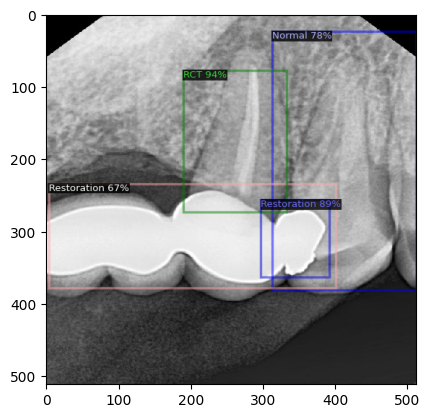



Classes : 
 tensor([4, 4, 5, 3], device='cuda:0')
Scores : 
 tensor([0.9198, 0.7623, 0.7088, 0.6855], device='cuda:0')


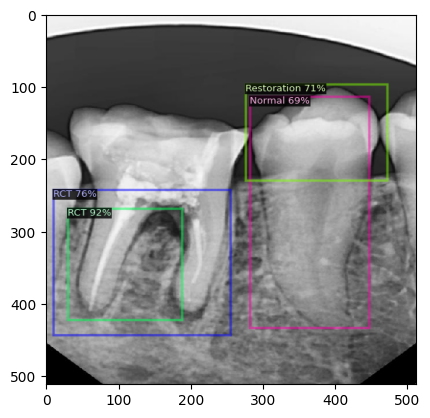



Classes : 
 tensor([5, 3], device='cuda:0')
Scores : 
 tensor([0.9193, 0.7204], device='cuda:0')


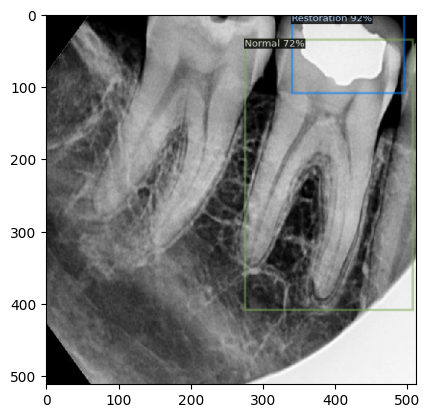



Classes : 
 tensor([3, 4, 4, 3, 5, 5], device='cuda:0')
Scores : 
 tensor([0.7716, 0.7679, 0.7359, 0.7327, 0.7221, 0.7091], device='cuda:0')


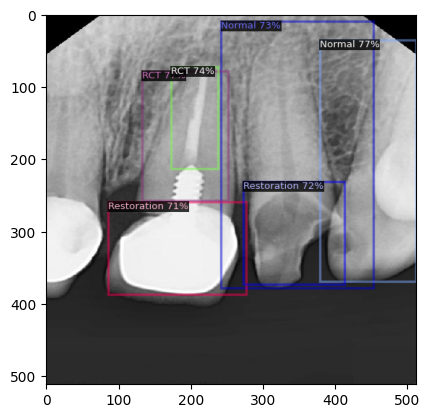



Classes : 
 tensor([3], device='cuda:0')
Scores : 
 tensor([0.8522], device='cuda:0')


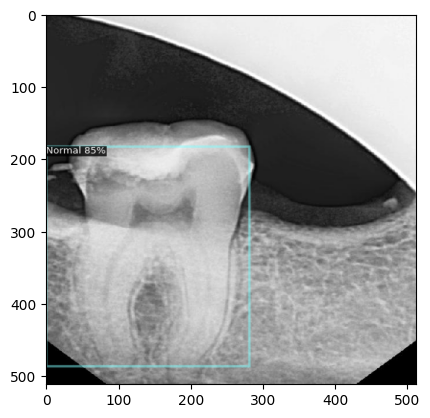



Classes : 
 tensor([5, 5, 3], device='cuda:0')
Scores : 
 tensor([0.9054, 0.8554, 0.6574], device='cuda:0')


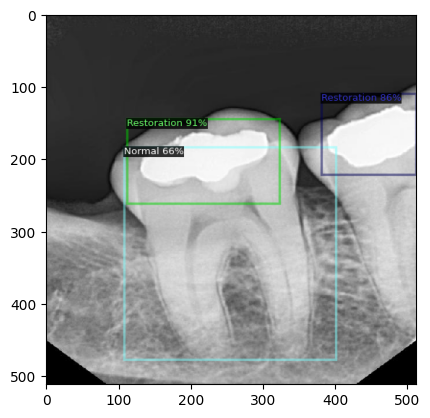



Classes : 
 tensor([5, 3, 5], device='cuda:0')
Scores : 
 tensor([0.8988, 0.7197, 0.6762], device='cuda:0')


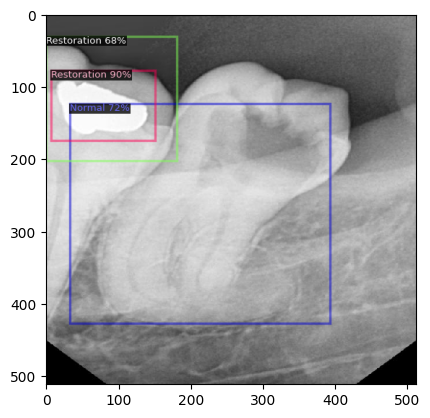



Classes : 
 tensor([5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8145, 0.7356, 0.6924], device='cuda:0')


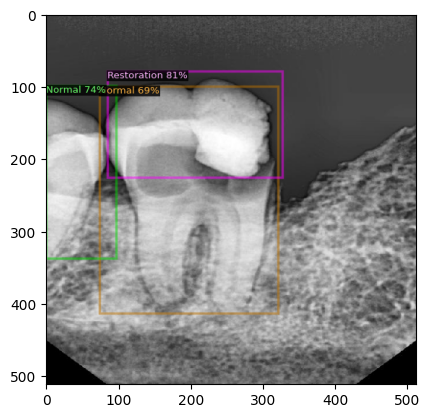



Classes : 
 tensor([3, 4], device='cuda:0')
Scores : 
 tensor([0.7048, 0.6505], device='cuda:0')


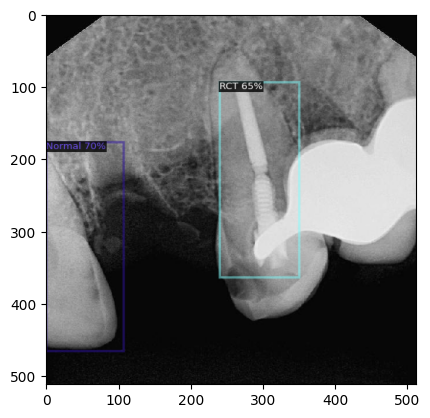



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.8161, 0.8078], device='cuda:0')


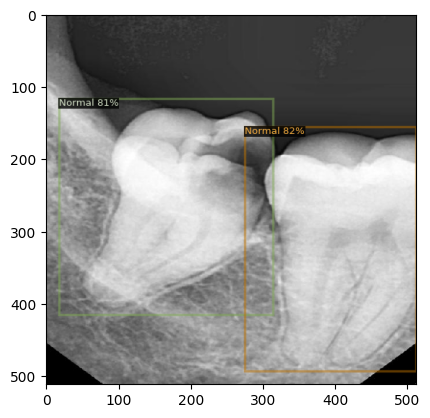



Classes : 
 tensor([5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9083, 0.7175, 0.6788], device='cuda:0')


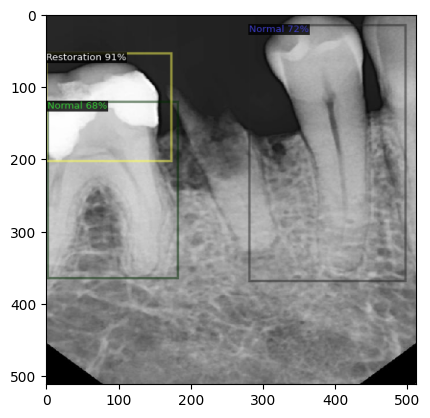



Classes : 
 tensor([4, 5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9554, 0.9243, 0.8017, 0.7655], device='cuda:0')


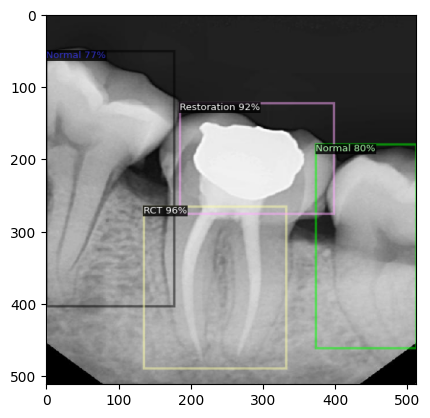



Classes : 
 tensor([5, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8292, 0.7465, 0.6789], device='cuda:0')


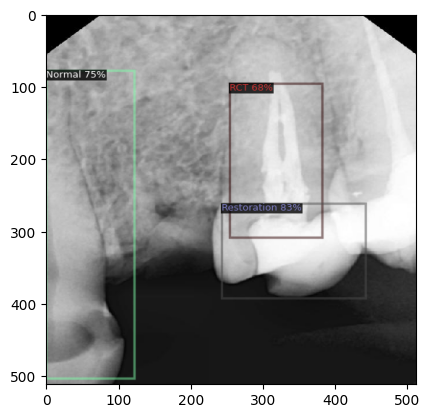



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7859, 0.7443, 0.7054], device='cuda:0')


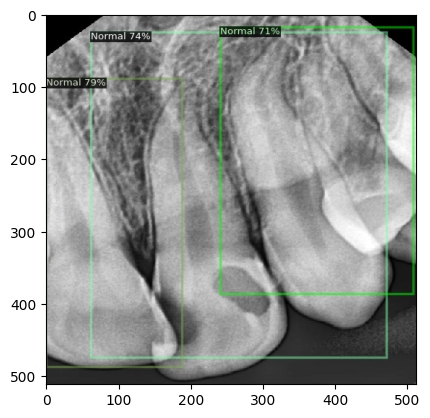



Classes : 
 tensor([4, 5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8409, 0.7934, 0.7240, 0.6809], device='cuda:0')


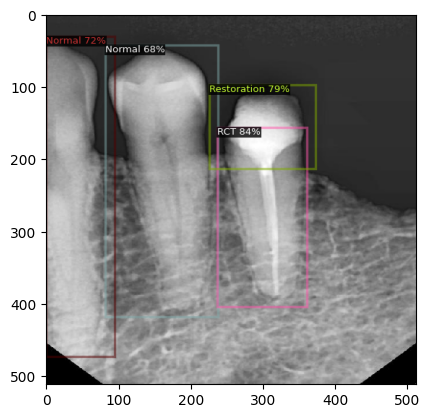



Classes : 
 tensor([5, 5, 3], device='cuda:0')
Scores : 
 tensor([0.9278, 0.8664, 0.7822], device='cuda:0')


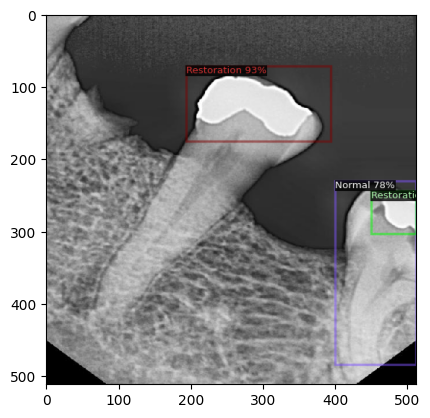



Classes : 
 tensor([4, 3, 4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.8950, 0.8110, 0.8086, 0.6623, 0.6333], device='cuda:0')


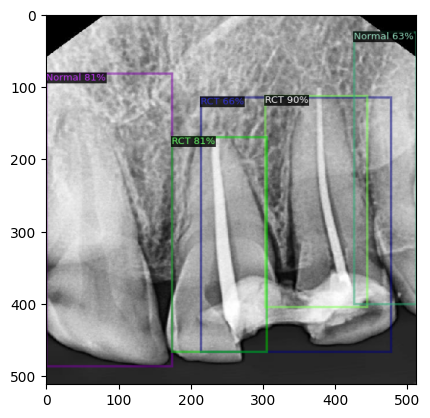



Classes : 
 tensor([5, 4, 3], device='cuda:0')
Scores : 
 tensor([0.8924, 0.7909, 0.6630], device='cuda:0')


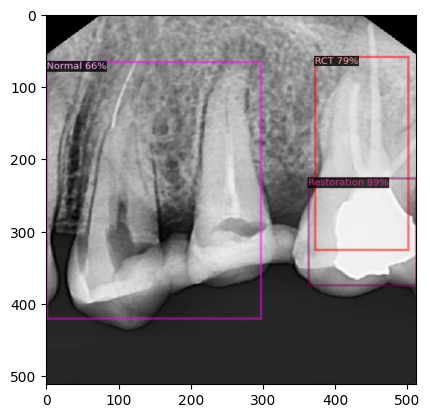



Classes : 
 tensor([3], device='cuda:0')
Scores : 
 tensor([0.6029], device='cuda:0')


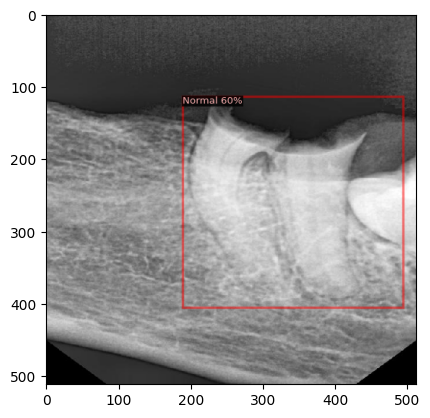



Classes : 
 tensor([4, 4, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8851, 0.8844, 0.7915, 0.7448, 0.6970], device='cuda:0')


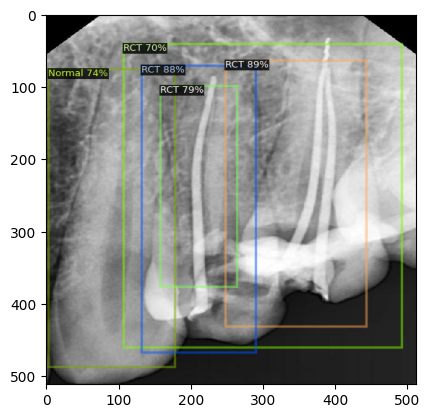



Classes : 
 tensor([4, 4, 3, 5, 5], device='cuda:0')
Scores : 
 tensor([0.9666, 0.7561, 0.7540, 0.6984, 0.6711], device='cuda:0')


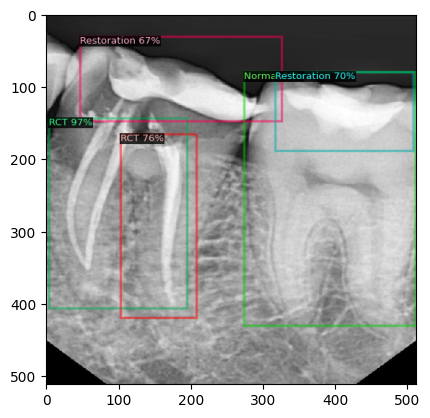



Classes : 
 tensor([4, 4], device='cuda:0')
Scores : 
 tensor([0.9826, 0.7678], device='cuda:0')


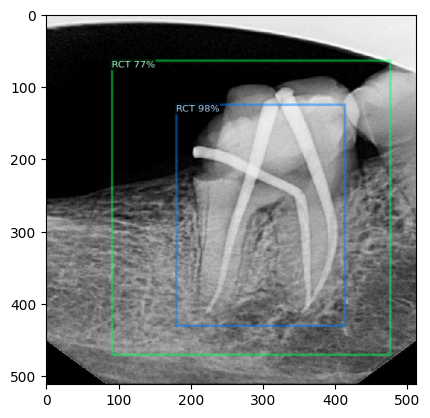



Classes : 
 tensor([3, 3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7803, 0.7468, 0.7237, 0.6854, 0.6777], device='cuda:0')


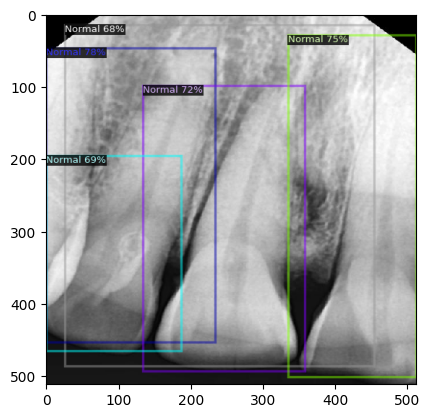



Classes : 
 tensor([4, 3, 4, 5, 4], device='cuda:0')
Scores : 
 tensor([0.9394, 0.8302, 0.8095, 0.6330, 0.6280], device='cuda:0')


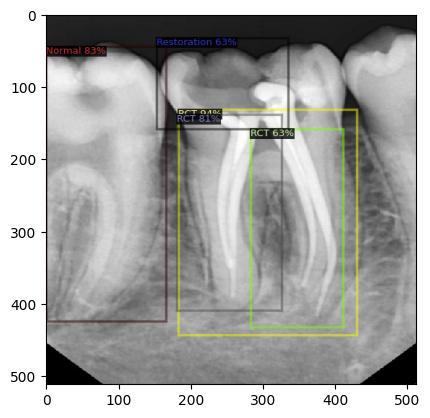



Classes : 
 tensor([5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9248, 0.7897, 0.7620], device='cuda:0')


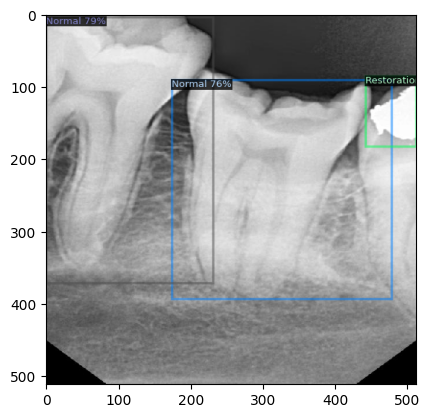



Classes : 
 tensor([4, 5, 3, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9512, 0.8114, 0.7931, 0.6802, 0.6604, 0.6070], device='cuda:0')


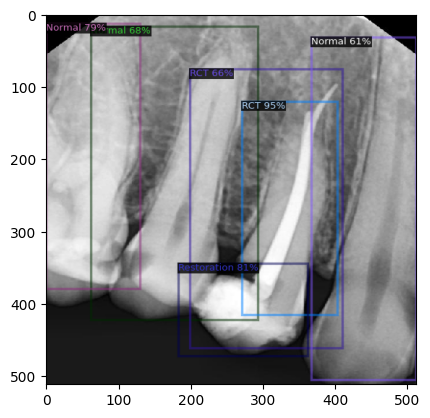



Classes : 
 tensor([4, 3], device='cuda:0')
Scores : 
 tensor([0.9746, 0.7887], device='cuda:0')


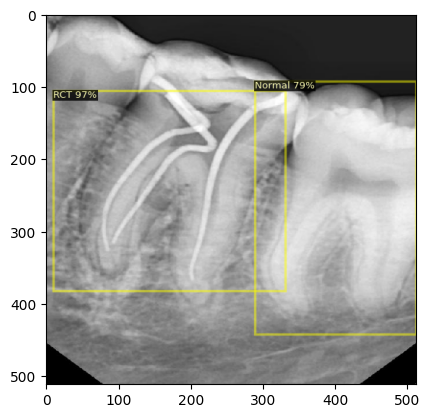



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.9088, 0.6244], device='cuda:0')


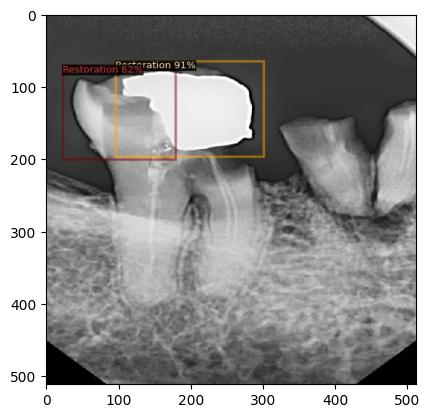



Classes : 
 tensor([4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.9659, 0.7965, 0.6917], device='cuda:0')


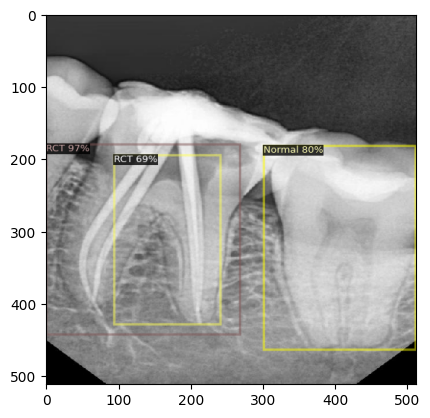



Classes : 
 tensor([4, 5, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9642, 0.9279, 0.7903, 0.7890], device='cuda:0')


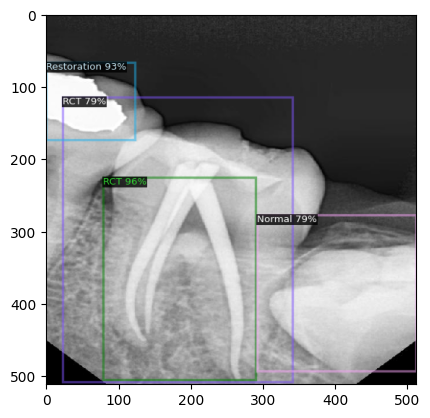



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.6845, 0.6628], device='cuda:0')


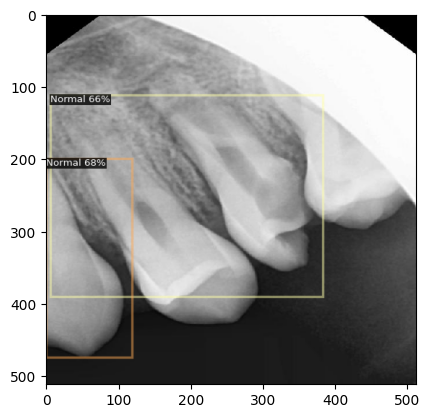



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.8320, 0.6410], device='cuda:0')


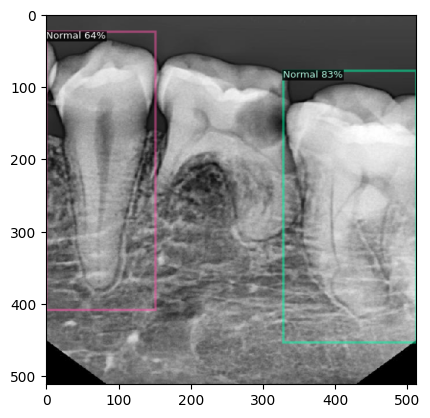



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8704, 0.7947, 0.6776], device='cuda:0')


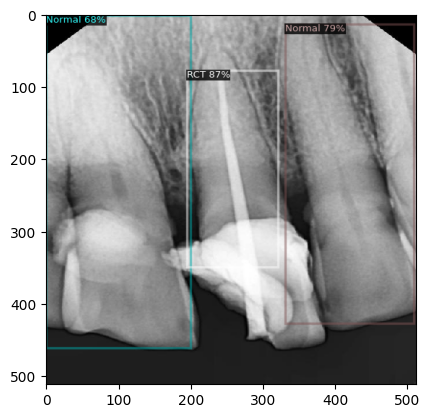



Classes : 
 tensor([4, 3], device='cuda:0')
Scores : 
 tensor([0.9572, 0.7997], device='cuda:0')


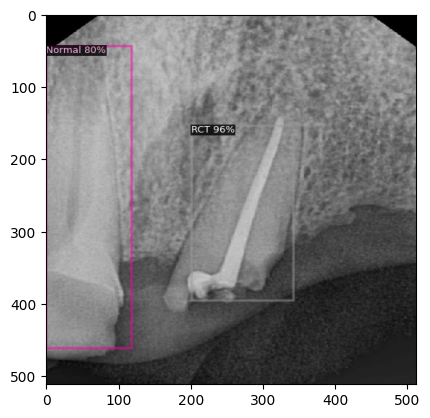



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7953, 0.6998, 0.6848], device='cuda:0')


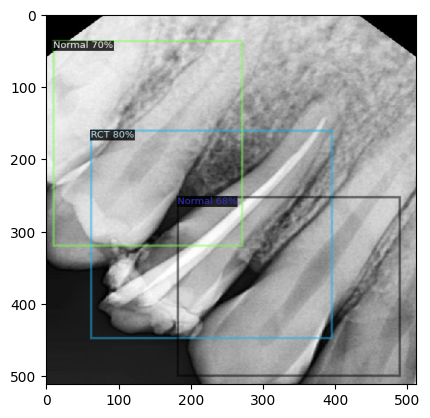



Classes : 
 tensor([5, 4, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8989, 0.8959, 0.7659, 0.7346, 0.6924], device='cuda:0')


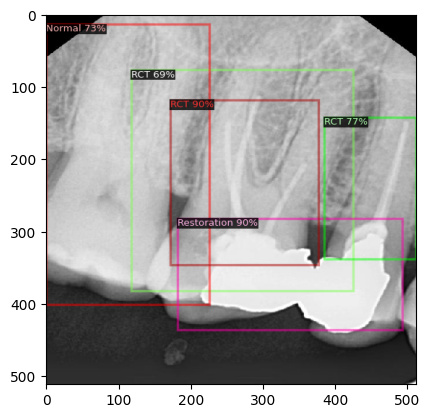



Classes : 
 tensor([5, 4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9067, 0.8883, 0.7224, 0.6812], device='cuda:0')


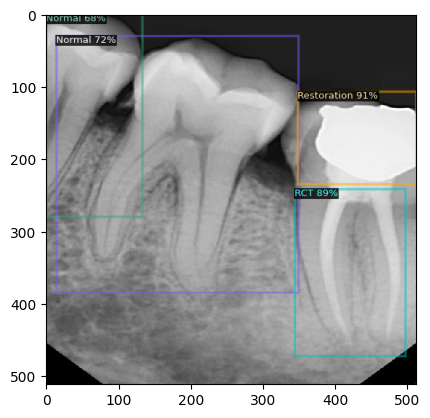



Classes : 
 tensor([3, 5, 3, 5], device='cuda:0')
Scores : 
 tensor([0.7673, 0.7672, 0.6243, 0.6086], device='cuda:0')


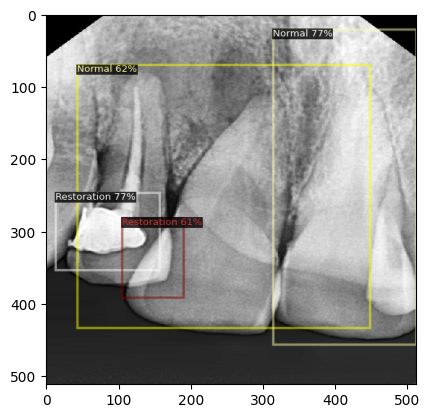



Classes : 
 tensor([4, 3], device='cuda:0')
Scores : 
 tensor([0.8622, 0.6096], device='cuda:0')


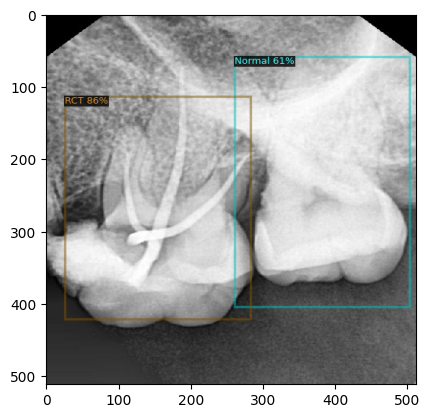



Classes : 
 tensor([3, 5, 3, 5, 3], device='cuda:0')
Scores : 
 tensor([0.8008, 0.6738, 0.6594, 0.6375, 0.6211], device='cuda:0')


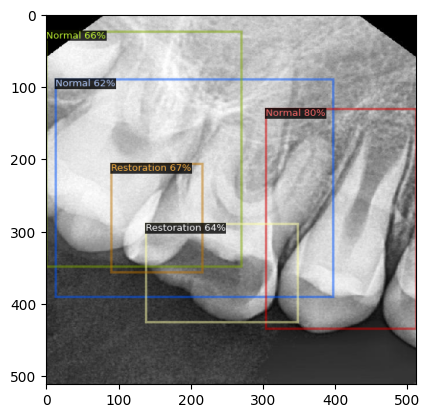



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8071, 0.7475, 0.6583], device='cuda:0')


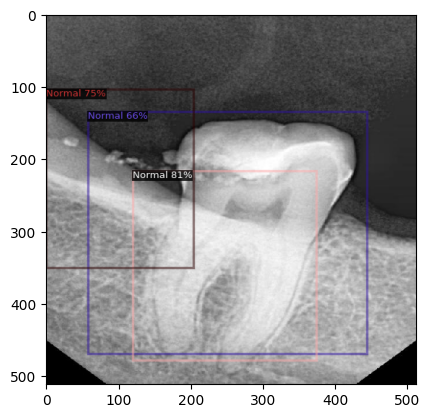



Classes : 
 tensor([4, 3, 3, 5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9229, 0.7917, 0.7497, 0.7122, 0.6671, 0.6331], device='cuda:0')


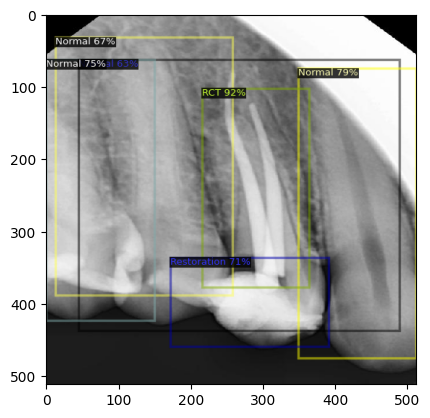



Classes : 
 tensor([3, 5], device='cuda:0')
Scores : 
 tensor([0.7492, 0.7478], device='cuda:0')


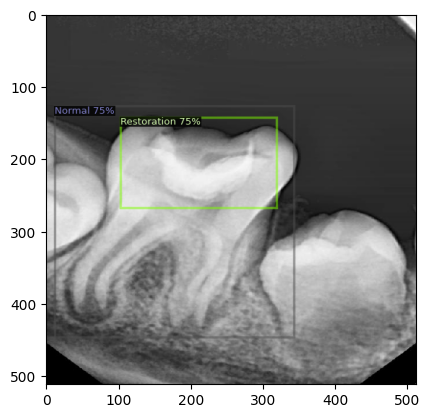



Classes : 
 tensor([5, 4, 4, 3, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8848, 0.8635, 0.8316, 0.7912, 0.7209, 0.6781], device='cuda:0')


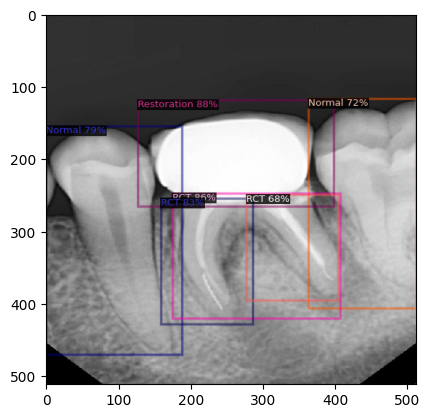



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.6834, 0.6818], device='cuda:0')


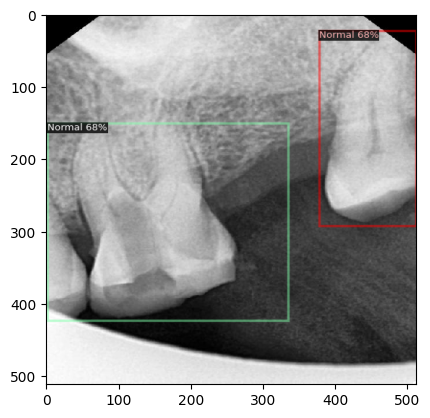



Classes : 
 tensor([4, 3], device='cuda:0')
Scores : 
 tensor([0.9302, 0.6840], device='cuda:0')


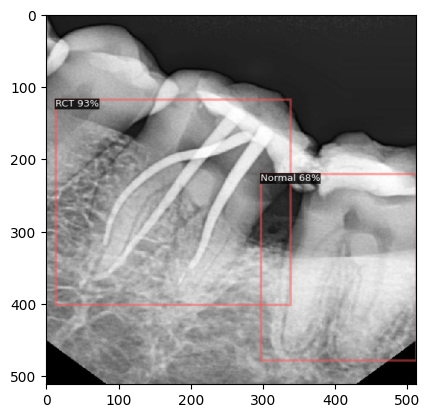



Classes : 
 tensor([5, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8338, 0.7655, 0.7630, 0.7120], device='cuda:0')


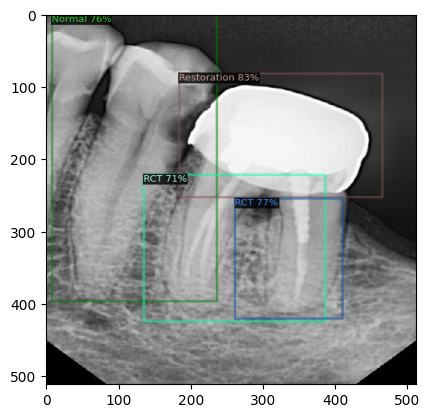



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8272, 0.7449, 0.7228], device='cuda:0')


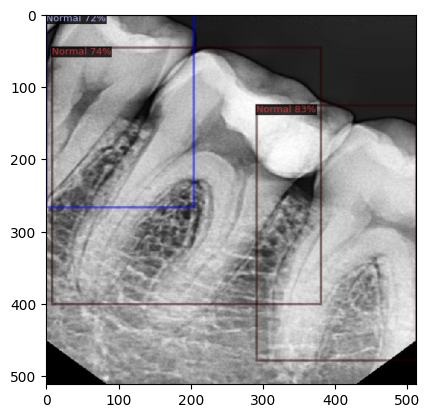



Classes : 
 tensor([3, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.8086, 0.7721, 0.7408, 0.6564], device='cuda:0')


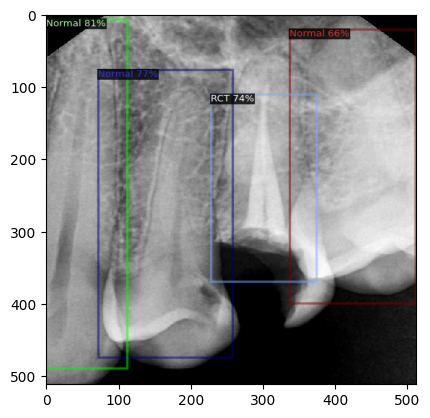



Classes : 
 tensor([4, 3, 5, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9726, 0.8083, 0.7520, 0.7386, 0.7159], device='cuda:0')


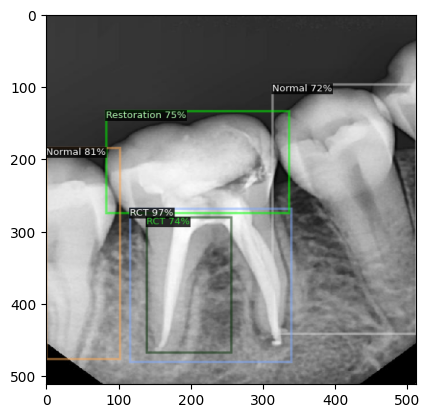



Classes : 
 tensor([4, 4, 4], device='cuda:0')
Scores : 
 tensor([0.9220, 0.7385, 0.6107], device='cuda:0')


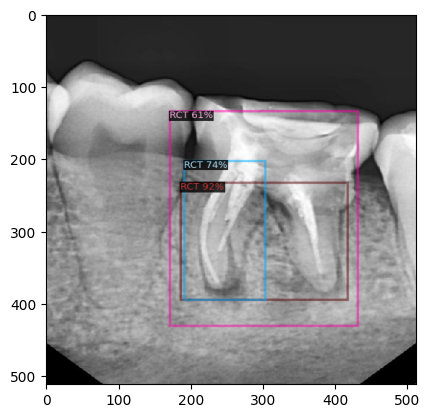



Classes : 
 tensor([4, 4, 4, 3, 4], device='cuda:0')
Scores : 
 tensor([0.9151, 0.8686, 0.7587, 0.7032, 0.6619], device='cuda:0')


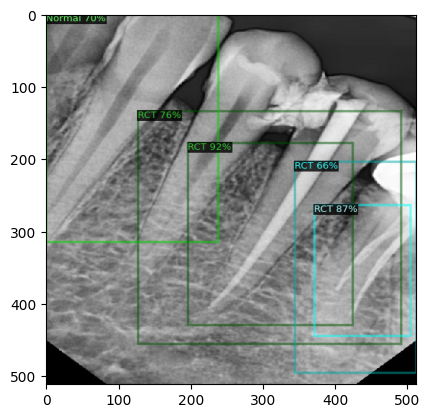



Classes : 
 tensor([3, 3, 3, 3, 3, 5], device='cuda:0')
Scores : 
 tensor([0.8000, 0.7957, 0.7034, 0.7018, 0.6795, 0.6177], device='cuda:0')


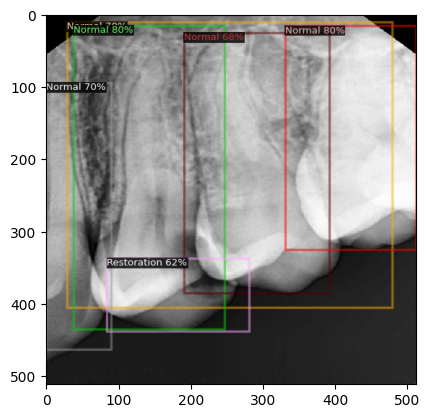



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.6856, 0.6578], device='cuda:0')


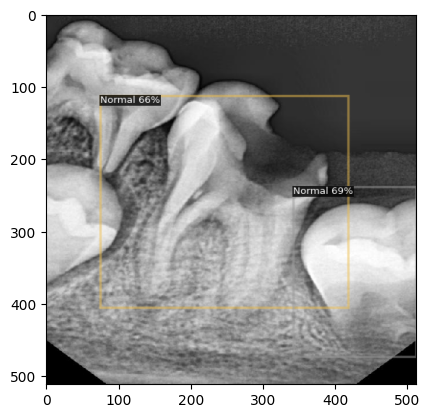



Classes : 
 tensor([4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9190, 0.8489, 0.7166], device='cuda:0')


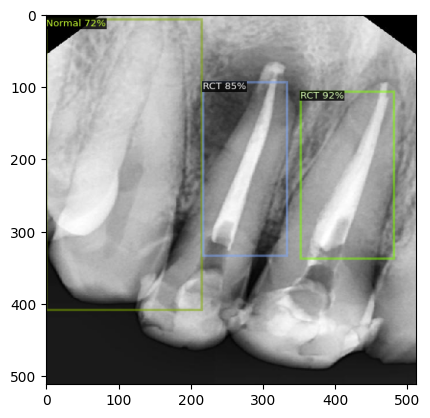



Classes : 
 tensor([5, 4, 5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9093, 0.8495, 0.6340, 0.6267, 0.6132], device='cuda:0')


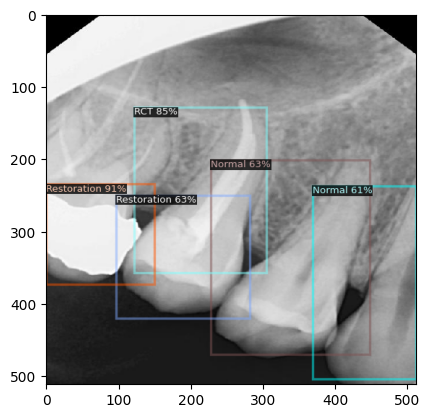



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9547, 0.7981, 0.7643], device='cuda:0')


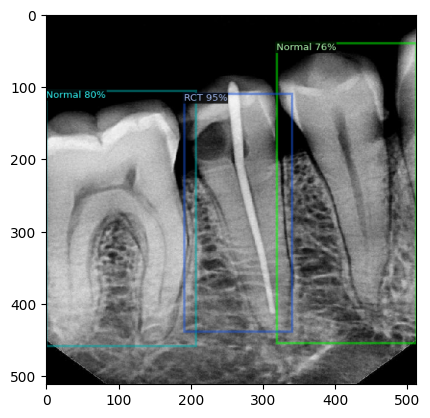



Classes : 
 tensor([3, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.7766, 0.7753, 0.7361, 0.7178], device='cuda:0')


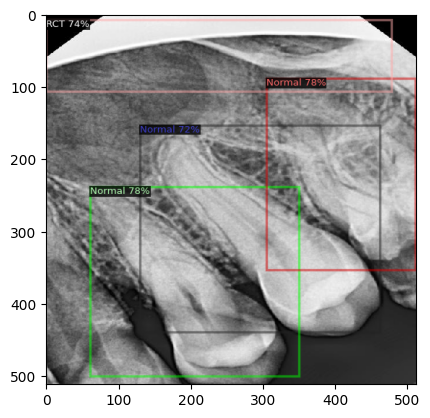



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8118, 0.7376, 0.7279, 0.6873], device='cuda:0')


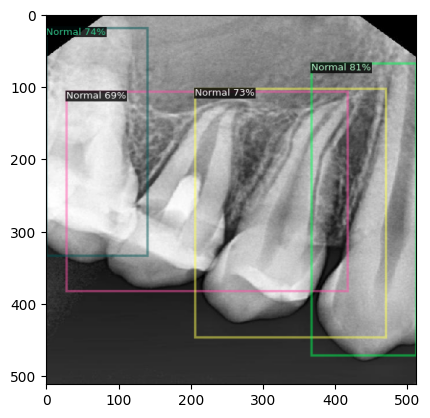



Classes : 
 tensor([4, 3], device='cuda:0')
Scores : 
 tensor([0.8508, 0.6768], device='cuda:0')


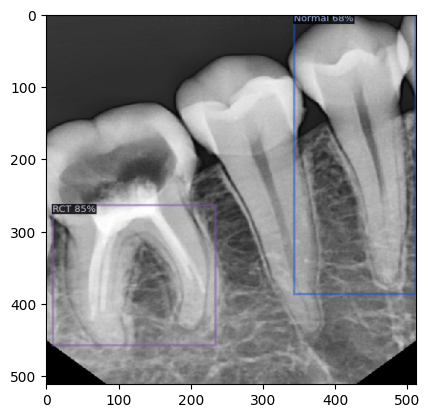



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.7142, 0.6054], device='cuda:0')


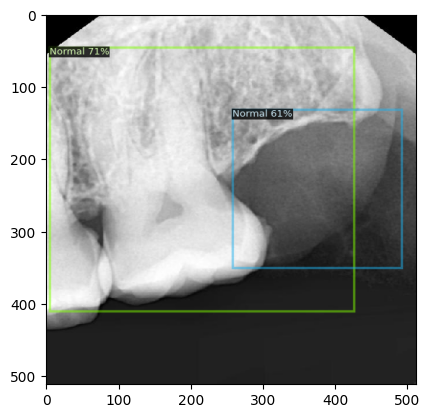



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7612, 0.6575, 0.6478, 0.6416], device='cuda:0')


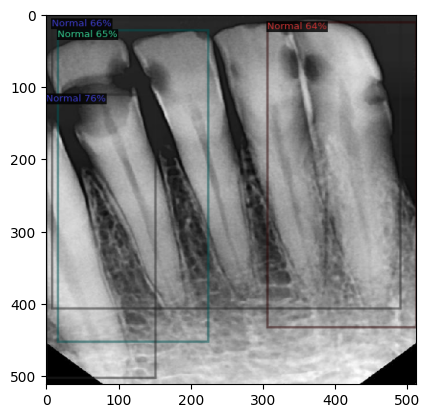



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.7507, 0.6821], device='cuda:0')


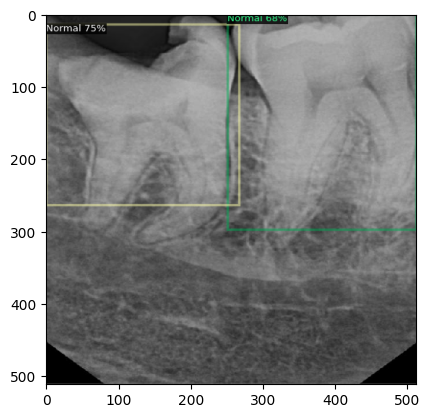



Classes : 
 tensor([4, 3, 4, 5, 4, 4], device='cuda:0')
Scores : 
 tensor([0.9700, 0.7851, 0.7735, 0.7222, 0.6967, 0.6249], device='cuda:0')


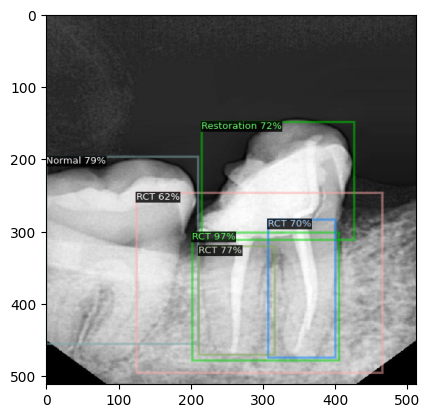



Classes : 
 tensor([4, 4, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9117, 0.8594, 0.7226, 0.6943, 0.6457], device='cuda:0')


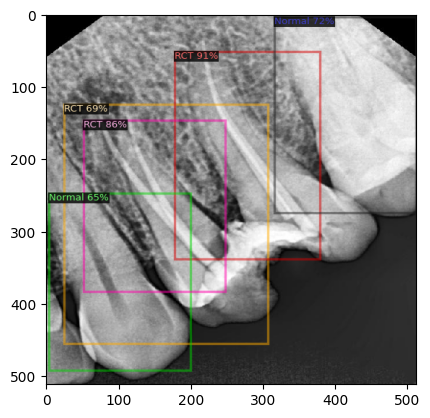



Classes : 
 tensor([4, 5, 3, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9022, 0.7437, 0.7156, 0.7138, 0.6646], device='cuda:0')


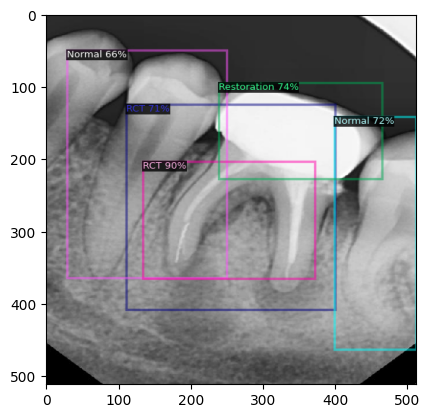



Classes : 
 tensor([4, 4, 5, 5, 3, 4], device='cuda:0')
Scores : 
 tensor([0.9563, 0.9522, 0.9447, 0.7854, 0.7424, 0.7250], device='cuda:0')


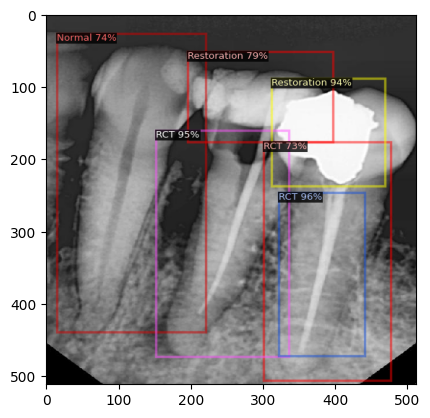



Classes : 
 tensor([4, 5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9750, 0.9378, 0.7912, 0.7353], device='cuda:0')


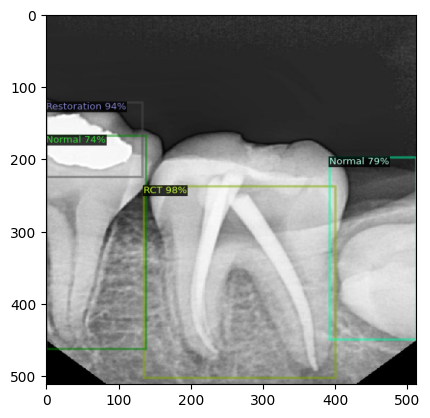



Classes : 
 tensor([4, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8867, 0.8020, 0.7628, 0.7385], device='cuda:0')


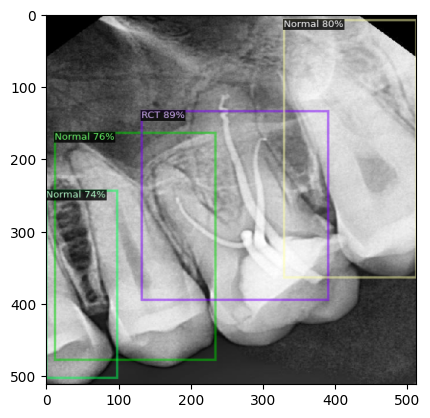



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9456, 0.7838, 0.7398], device='cuda:0')


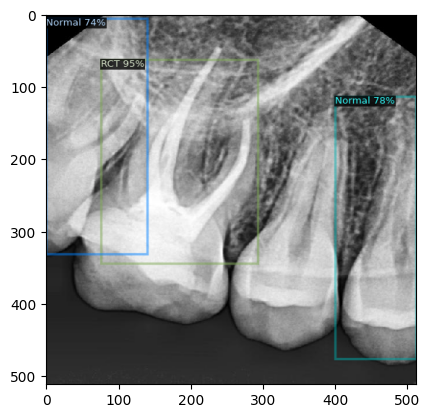



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7489, 0.7247, 0.6773, 0.6686], device='cuda:0')


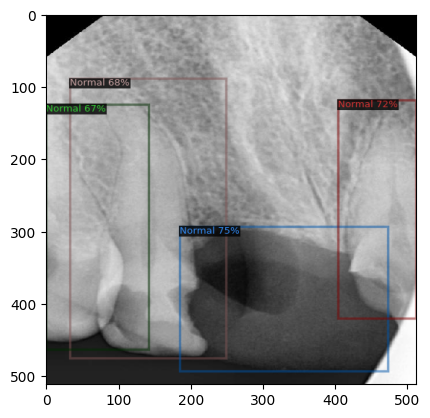



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.7601, 0.7013], device='cuda:0')


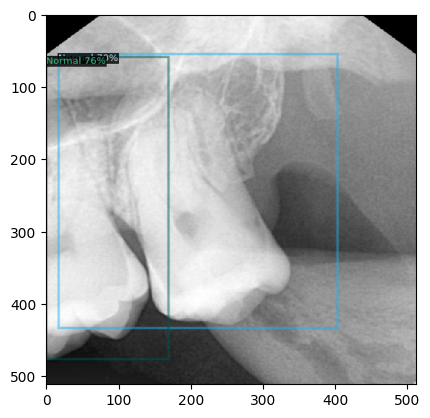



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7938, 0.7330, 0.6732, 0.6143], device='cuda:0')


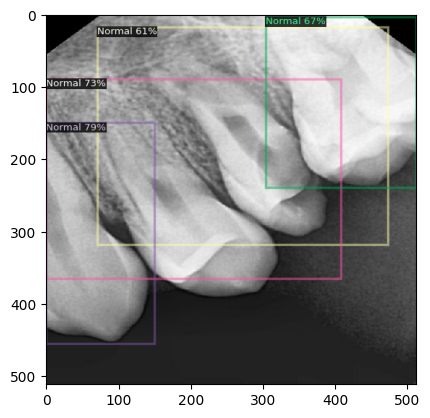



Classes : 
 tensor([3, 5, 3], device='cuda:0')
Scores : 
 tensor([0.7070, 0.6891, 0.6565], device='cuda:0')


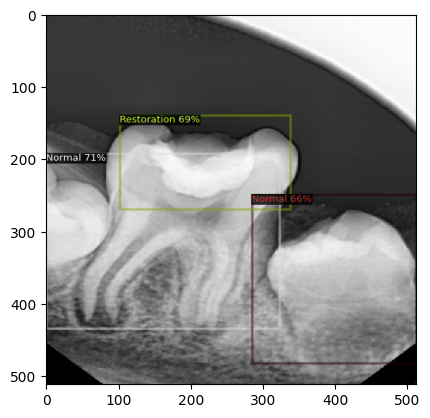



Classes : 
 tensor([4, 3, 3, 5, 4, 4], device='cuda:0')
Scores : 
 tensor([0.9610, 0.7922, 0.6697, 0.6481, 0.6447, 0.6053], device='cuda:0')


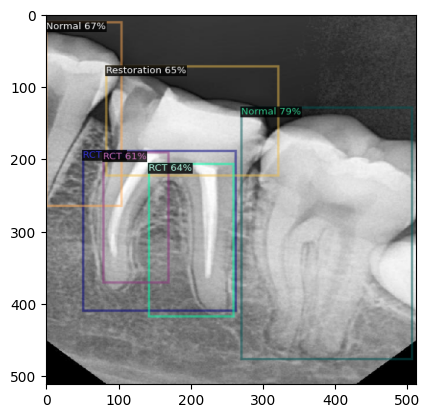



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8614, 0.7142, 0.6239], device='cuda:0')


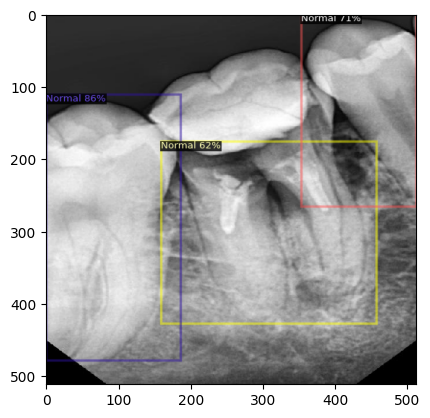



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7450, 0.6796, 0.6423], device='cuda:0')


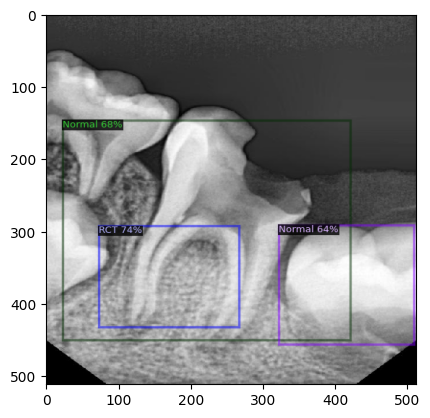



Classes : 
 tensor([3], device='cuda:0')
Scores : 
 tensor([0.6896], device='cuda:0')


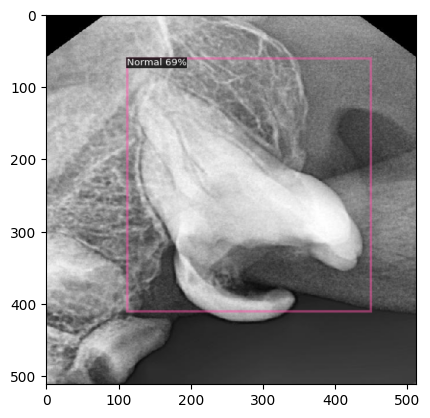



Classes : 
 tensor([4, 5, 4, 4, 5, 4, 4], device='cuda:0')
Scores : 
 tensor([0.9642, 0.9095, 0.8901, 0.8646, 0.7941, 0.6597, 0.6329],
       device='cuda:0')


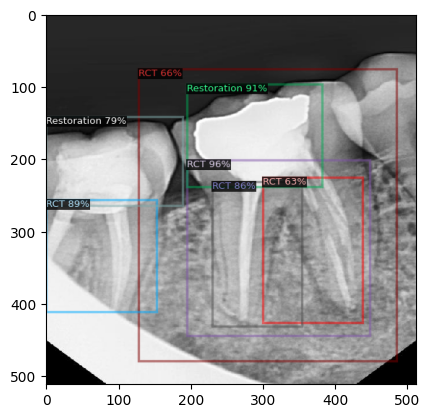



Classes : 
 tensor([4, 5, 4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9411, 0.9183, 0.8905, 0.8167, 0.6430], device='cuda:0')


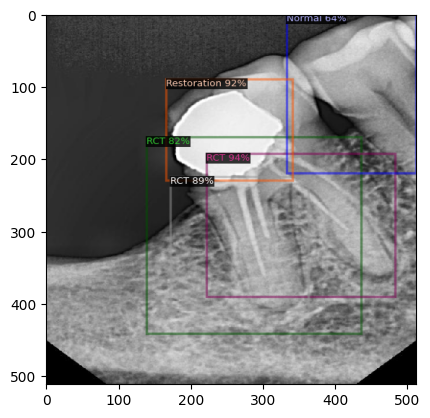



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8310, 0.7507, 0.6669], device='cuda:0')


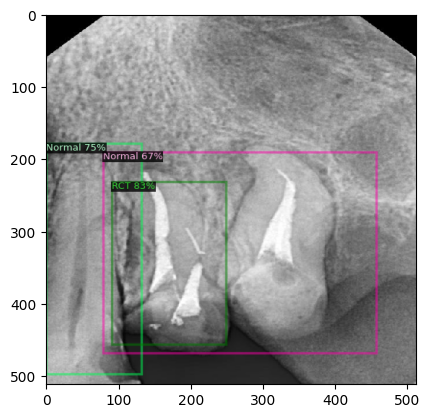



Classes : 
 tensor([4, 3, 4, 3, 4, 5, 4], device='cuda:0')
Scores : 
 tensor([0.9560, 0.7998, 0.7945, 0.7210, 0.6649, 0.6424, 0.6090],
       device='cuda:0')


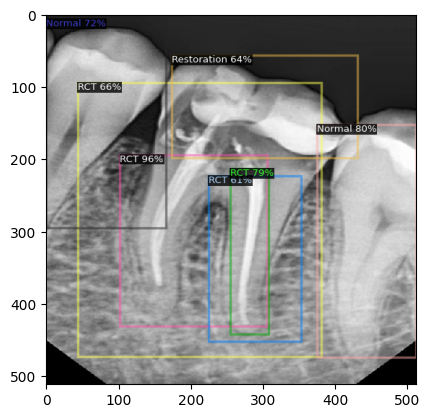



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7564, 0.7256, 0.6034], device='cuda:0')


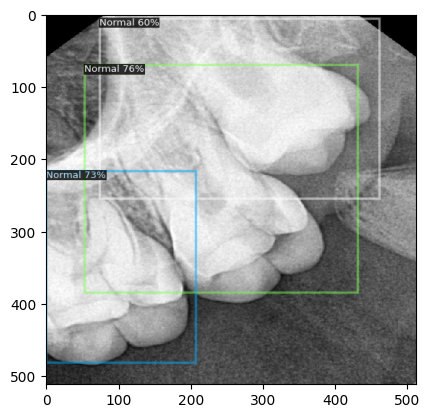



Classes : 
 tensor([3, 3, 5, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7976, 0.7425, 0.6611, 0.6517, 0.6402, 0.6279], device='cuda:0')


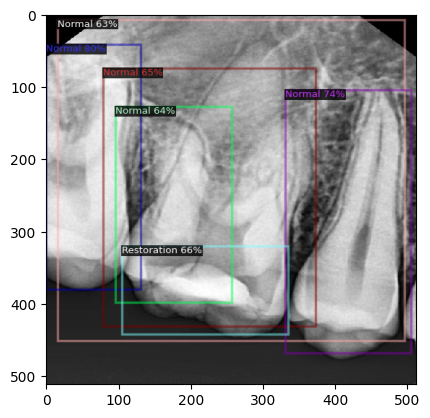



Classes : 
 tensor([4, 3, 3, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8691, 0.7695, 0.7035, 0.6783, 0.6048], device='cuda:0')


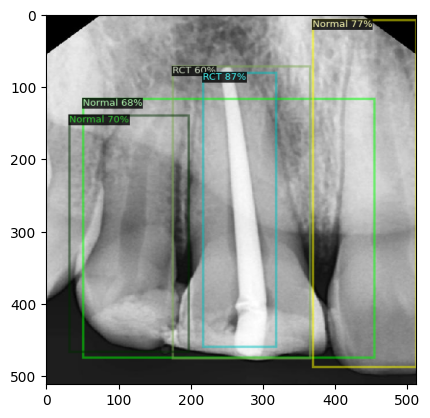



Classes : 
 tensor([5, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8570, 0.7366, 0.7220], device='cuda:0')


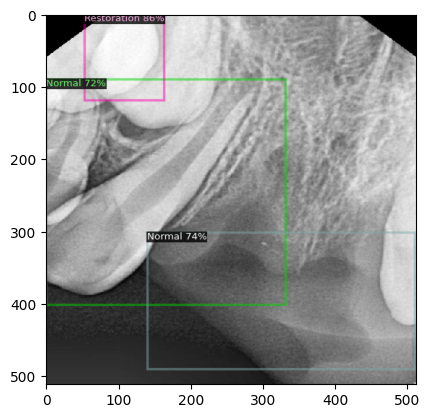



Classes : 
 tensor([3, 3, 5, 3], device='cuda:0')
Scores : 
 tensor([0.8605, 0.7407, 0.7195, 0.6066], device='cuda:0')


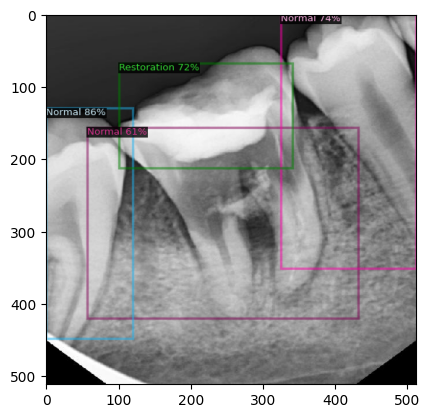



Classes : 
 tensor([4, 5, 5, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9324, 0.9296, 0.9094, 0.8464, 0.8228], device='cuda:0')


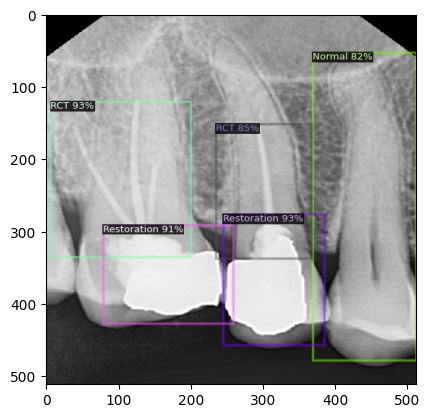



Classes : 
 tensor([4, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9237, 0.7614, 0.6163], device='cuda:0')


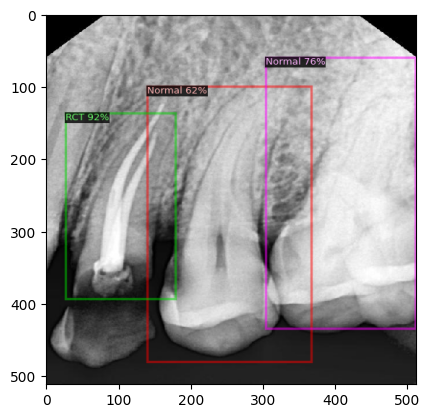



Classes : 
 tensor([4, 5, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.9016, 0.8564, 0.7898, 0.6733, 0.6232], device='cuda:0')


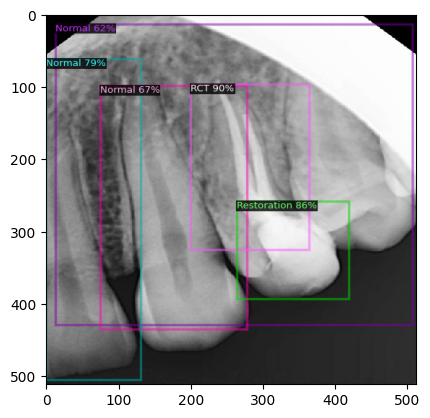



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.7884, 0.7252], device='cuda:0')


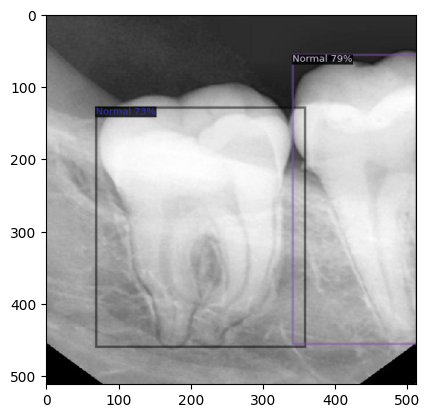



Classes : 
 tensor([5, 4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.9330, 0.9138, 0.7249, 0.6007], device='cuda:0')


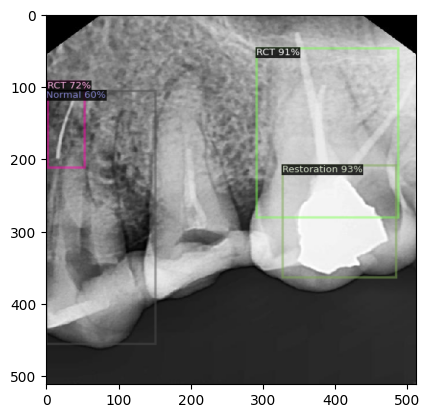



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.7684, 0.7023], device='cuda:0')


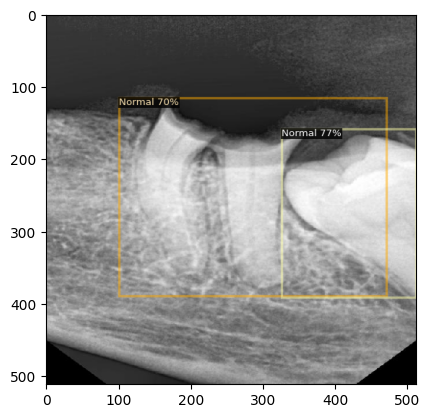



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8087, 0.6594, 0.6464, 0.6086], device='cuda:0')


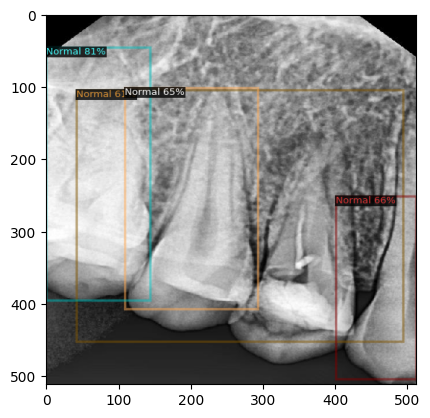



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7978, 0.7763, 0.7711], device='cuda:0')


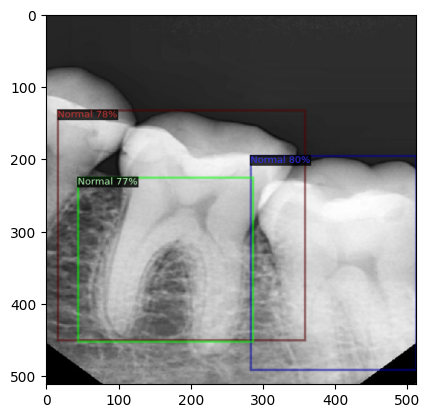



Classes : 
 tensor([3, 3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7954, 0.7871, 0.6355, 0.6039], device='cuda:0')


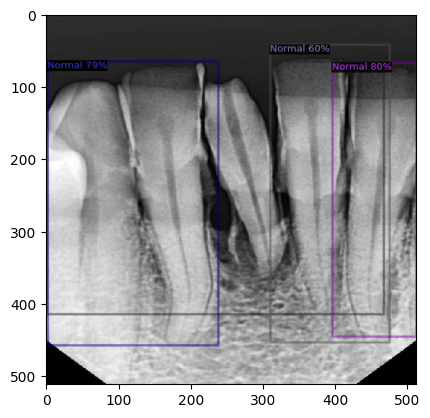



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.7630, 0.7500, 0.6517], device='cuda:0')


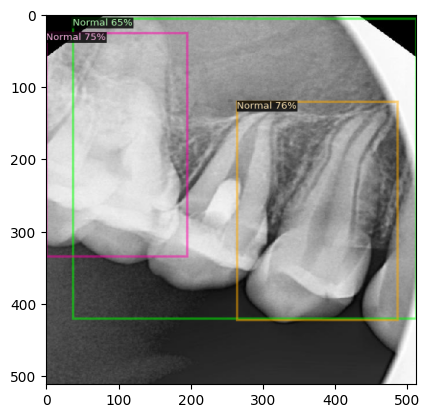



Classes : 
 tensor([4, 4, 3, 3, 3, 5], device='cuda:0')
Scores : 
 tensor([0.8402, 0.7338, 0.6814, 0.6720, 0.6576, 0.6275], device='cuda:0')


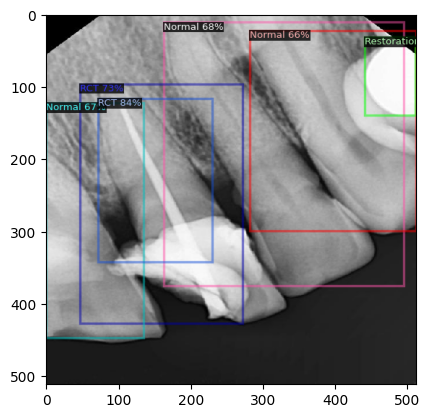



Classes : 
 tensor([3], device='cuda:0')
Scores : 
 tensor([0.6205], device='cuda:0')


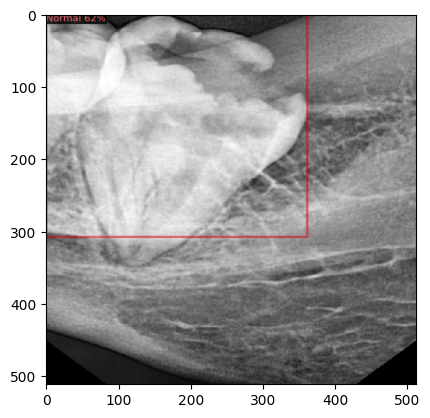



Classes : 
 tensor([3, 5], device='cuda:0')
Scores : 
 tensor([0.7628, 0.7225], device='cuda:0')


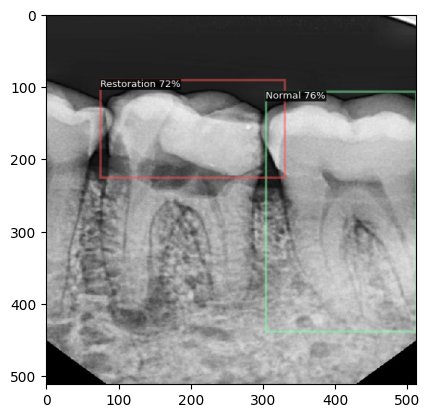



Classes : 
 tensor([3, 3, 3], device='cuda:0')
Scores : 
 tensor([0.8126, 0.8054, 0.7306], device='cuda:0')


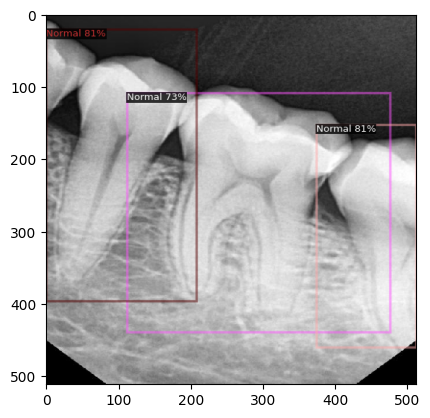



Classes : 
 tensor([3, 3], device='cuda:0')
Scores : 
 tensor([0.8651, 0.8035], device='cuda:0')


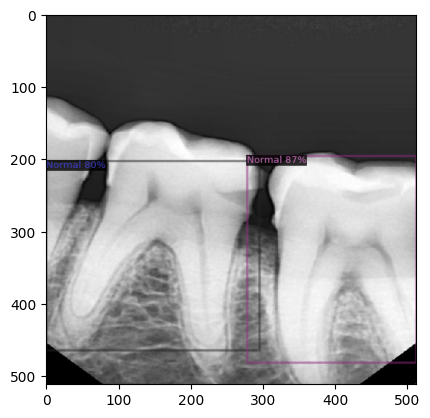



Classes : 
 tensor([4, 5, 3, 4, 3, 3, 4], device='cuda:0')
Scores : 
 tensor([0.8845, 0.7750, 0.7568, 0.7462, 0.6631, 0.6312, 0.6143],
       device='cuda:0')


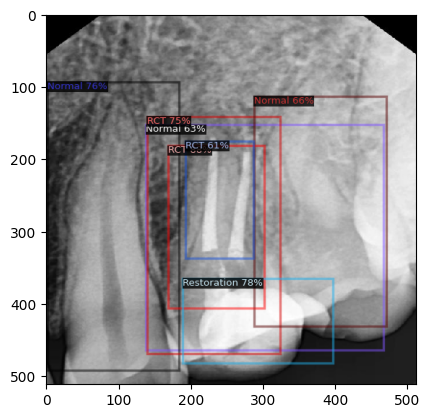



Classes : 
 tensor([4, 4, 3], device='cuda:0')
Scores : 
 tensor([0.8216, 0.7226, 0.6128], device='cuda:0')


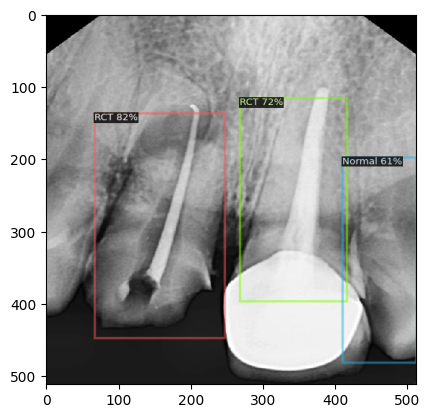

In [15]:
# Using saved model
my_cfg = get_cfg()
my_cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
my_cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6 # Set threshold for this model
my_cfg.MODEL.WEIGHTS = "/kaggle/working/output/model_final.pth"
my_cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6
my_model_detectron2 = DefaultPredictor(my_cfg)


from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob("/kaggle/working/RCNN-drop-classes-1/test/*jpg"):
  im = cv2.imread(imageName)
  outputs = my_model_detectron2(im)
  print("Classes : \n", outputs["instances"].pred_classes)
  print("Scores : \n", outputs["instances"].scores)

  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  plt.imshow(out.get_image()[:, :, ::-1])
  plt.show()
  print("\n")